In [80]:
import os
import sys
import re
import pandas as pd
import numpy as np
import Bio as bio
from Bio.Seq import Seq

# Library to do fast pairwise alignment:
# https://github.com/iosonofabio/seqanpy
sys.path.append('/home/fabio/university/phd/sequencing/libraries/seqanpy/build/lib.linux-x86_64-3.9')
import seqanpy

In [35]:
# Data locations
patient_id = ['1_002', '1_075', '1_140', '1_144', '5_030', '5_041', \
                '5_044', '5_089', '5_154', '5_193', '6_001', '6_020', \
                '6_025', '6_028', '1_019_01', '3_012_01', '3_037_01', \
                '3_047_01', '6_023_01'
                ]
pat_fdn = [x for x in os.listdir('../../../data/datasets/20200809_20kids/vdj') if os.path.isdir('../../../data/datasets/20200809_20kids/vdj/'+x)]
fn_10X = '../../../data/datasets/20200809_20kids/20200810_20kids_vdj_all_contig_annotations.csv.gz'
fn_changeod = {x: f'../../../data/datasets/20200809_20kids/vdj/{x}/filtered_contig_heavy_germ-pass.tsv' for x in pat_fdn}

### Read in and simplified data

In [36]:
df_cells = pd.read_csv(fn_10X, sep=",")
df_cells['patient_sample'] = [x.replace('-', '_') for x in df_cells['patient_sample'].values]
df_cells['unique_contig_id'] = df_cells['patient_sample'] + '-' + df_cells['contig_id']

### No. of mutation counts

In [67]:
df_all_patients = []


# for each patient, count mutations in all cells
for p in pat_fdn:
    if not os.path.isfile(fn_changeod[p]):
        continue
    df_sequences = pd.read_csv(fn_changeod[p] , sep = "\t", header = 0)
    df_sequences['unique_contig_id'] = p + '-' + df_sequences['sequence_id']

    mutation_count = []
    for i in range(len(df_sequences)) : 
        
        seq_align = Seq(df_sequences.loc[i, "sequence_alignment"])
        germline = Seq(df_sequences.loc[i, "germline_alignment"])

        m_count=0
        for n1,n2 in zip(seq_align,germline):
            if ((n1 != 'N') and (n2 != 'N')) and (n1 != n2):
                m_count+=1 
                
        mutation_count.append(m_count)
    df_sequences["mutations"] = mutation_count
    df_sequences["patient_id"] = p
    df_all_patients.append(df_sequences)

df_all_patients = pd.concat(df_all_patients)

### simplified and merge data

In [68]:
df_all_patients['unique_sequence_id'] = df_all_patients['patient_id'] + '-' + df_all_patients['sequence_id']
merge_data = pd.merge(df_all_patients, df_cells, left_on = 'unique_contig_id', right_on = 'unique_contig_id')
simplified_all = merge_data[['unique_contig_id', 'chain','sequence_alignment', 'germline_alignment', 'clone_id', \
                        'mutations', 'patient_id']]

filter_all = simplified_all[simplified_all['mutations'] < 80]

In [73]:
filter_all.columns

Index(['unique_contig_id', 'chain', 'sequence_alignment', 'germline_alignment',
       'clone_id', 'mutations', 'patient_id', 'germline_aa'],
      dtype='object')

## Translate original and germline

In [77]:
def translate_column(df, col):
    from Bio.Seq import translate

    aas = []
    for i, seq in enumerate(df[col]):
        seq = seq.replace('.', '')
        for rf in range(3):
            seq_rf = seq[rf:]
            seq_rf = seq_rf[:(len(seq_rf) // 3) * 3]

            try:
                aa = translate(seq_rf)
            except:
                continue

            n_stops = aa.count('*')
            if n_stops == 0:
                break
        else:
            aa = ''

        aas.append(aa)
    return aas


filter_all['germline_aa'] = translate_column(filter_all, 'germline_alignment')
filter_all['seq_aa'] = translate_column(filter_all, 'sequence_alignment')

# the length is sometimes different, when the beginning of the sequence happens to be trimmed off
# therefore we abandon the alignment and realign ourselves
ind = (filter_all['germline_aa'].map(len) != filter_all['seq_aa'].map(len))
filter_all.loc[ind]

<ipython-input-77-d01e7514e9a2>:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filter_all['germline_aa'] = translate_column(filter_all, 'germline_alignment')
<ipython-input-77-d01e7514e9a2>:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filter_all['seq_aa'] = translate_column(filter_all, 'sequence_alignment')


,unique_contig_id,chain,sequence_alignment,germline_alignment,clone_id,mutations,patient_id,germline_aa,seq_aa
81,5_193-CTAGTGATCAATCTCT-1_contig_2,IGH,CAGGTGCAGCTGGTGCAGTCTGGGGCT...GAGGTGAAGAAGCCTG...,CAGGTGCAGCTGGTGCAGTCTGGGGCT...GAGGTGAAGAAGCCTG...,173_157,16,5_193,QVQLVQSGAEVKKPGASVKVSCKASGYTFTSYYMHWVRQAPGQGLE...,
94,5_193-GCTGCTTTCCTTAATC-1_contig_2,IGH,........................CCA...GGACTGGTGAAGCCTT...,CAGGTGCAGCTGCAGGAGTCGGGCCCA...GGACTGGTGAAGCCTT...,24_53,45,5_193,QVQLQESGPGLVKPSETLSLTCTVSGGSISSYYWSWIRQPPGKGLE...,PGLVKPSETLSVTCSVSGGSISSSSWSWIRQPPGKKLEWIGYISDT...
117,5_193-AACTCTTAGGGCTTGA-1_contig_1,IGH,....TGCAGTTGGTGCAGTCCGGGGGA...GGCTTAGTTCAGCCGG...,GAGGTGCAGCTGGTGGAGTCCGGGGGA...GGCTTAGTTCAGCCTG...,47_149,30,5_193,EVQLVESGGGLVQPGGSLRLSCAASGFTFSSYWMHWVRQAPGKGLV...,QLVQSGGGLVQPGGSLRLSCAASGFTFSDYWIHWVRQGPGKGLVWV...
147,5_193-TGAGGGATCACCATAG-1_contig_1,IGH,CAGGTGCAGCTGGTGGAGTCTGGGGGA...GGCGTGGTCCAGCCTG...,CAGGTGCAGCTGGTGGAGTCTGGGGGA...GGCGTGGTCCAGCCTG...,72_153,31,5_193,QVQLVESGGGVVQPGGSLRLSCAASGFTFSSYGMHWVRQAPGKGLE...,
160,5_193-GAGGTGATCAGAGGTG-1_contig_2,IGH,......................GGGGA...GGCTTGGTAAAGCCAG...,GAGGTGCAGCTGGTGGAGTCTGGGGGA...GGCTTGGTAAAGCCAG...,84_43,22,5_193,EVQLVESGGGLVKPGRSLRLSCTASGFTFGDYAMSWFRQAPGKGLE...,GGLVKPGRSLRLSCTASGFTFGDYAMSWFRQAPGKGLEWVGFIRSK...
...,...,...,...,...,...,...,...,...,...
8968,3_037_01-GCAGTTAGTGCGATAG-1_contig_1,IGH,CAGGTGCAGCTGCAGGAGTCGGGCCCA...GGACTGGTGAAGCCTT...,CAGGTGCAGCTGCAGGAGTCGGGCCCA...GGACTGGTGAAGCCTT...,43_44,26,3_037_01,QVQLQESGPGLVKPSQTLSLTCTVSGGSISSGDYYWSWIRQPPGKG...,
8969,3_037_01-GTTCATTTCCGGCACA-1_contig_1,IGH,CAGGTGCAGCTGCAGGAGTCGGGCCCA...GGACTGGTGAAGCCTT...,CAGGTGCAGCTGCAGGAGTCGGGCCCA...GGACTGGTGAAGCCTT...,43_44,30,3_037_01,QVQLQESGPGLVKPSQTLSLTCTVSGGSISSGDYYWSWIRQPPGKG...,
8970,3_037_01-GATGAAAGTCCATGAT-1_contig_1,IGH,CAGGTGCAGCTGCAGGAGTCGGGCCCA...GGACTGGTGAAGCCTT...,CAGGTGCAGCTGCAGGAGTCGGGCCCA...GGACTGGTGAAGCCTT...,44_272,30,3_037_01,QVQLQESGPGLVKPSQTLSLTCTVSGGSISSGDYYWSWIRQPPGKG...,
8986,3_037_01-AAATGCCGTATAATGG-1_contig_2,IGH,GAAGTGCAGCTGGTGCAGTCCGGAGCA...GAGGTCAAAAAGCCCG...,GAAGTGCAGCTGGTGCAGTCCGGAGCA...GAGGTGAAAAAGCCCG...,59_100,29,3_037_01,EVQLVQSGAEVKKPGESLRISCKGSGYSFTSYWISWVRQMPGKGLE...,


In [91]:
seq_ali_aa = []
germline_ali_aa = []
seq_ali_aa_filled = []
for _, row in filter_all.iterrows():
    seqaa = row['seq_aa']
    germaa = row['germline_aa']
    score, ali1, ali2 = seqanpy.align_overlap(germaa, seqaa)
    germline_ali_aa.append(ali1)
    seq_ali_aa.append(ali2)
    
    tmp = ali2
    if (len(ali2) > 0):
        if (ali2[0] == '-') or (ali2[-1] == '-'):
            i_start = len(ali2) - len(ali2.lstrip('-'))
            i_end = len(ali2.rstrip('-'))
            tmp = ali1[:i_start] + ali2[i_start: i_end]
            if i_end != len(ali2):
                tmp += ali2[i_end:]
    seq_ali_aa_filled.append(tmp)
    
    if len(seqaa) != len(germaa):
        print(_)
        print('GERM:', ali1)
        print('SEQ: ', ali2)
        print('SEQF:', tmp)

        
df['seq_ali_aa'] = seq_ali_aa
df['germline_ali_aa'] = germline_ali_aa
df['seq_ali_aa_filled'] = seq_ali_aa_filled

81
GERM: 
SEQ:  
SEQF: 
94
GERM: QVQLQESGPGLVKPSETLSLTCTVSGGSISSYYWSWIRQPPGKGLEWIGYIYYSGSTNYNPSLKSRVTISVDTSKNQFSLKLSSVTAADTAVYYCARXXXXAGXXYWYFDLWGRGTLVTV
SEQ:  --------PGLVKPSETLSVTCSVSGGSISSSSWSWIRQPPGKKLEWIGYISDTGNTNSNPSLKSRVTISGDTSKNQFSLKLTSVTAADTAVYFCARRPPLAGSHYWYFDLWGRGTLVTV
SEQF: QVQLQESGPGLVKPSETLSVTCSVSGGSISSSSWSWIRQPPGKKLEWIGYISDTGNTNSNPSLKSRVTISGDTSKNQFSLKLTSVTAADTAVYFCARRPPLAGSHYWYFDLWGRGTLVTV
117
GERM: EVQLVESGGGLVQPGGSLRLSCAASGFTFSSYWMHWVRQAPGKGLVWVSRINSDGSSTSYADSVKGRFTISRDNAKNTLYLQMNSLRAEDTAVYYCAXXXXXXGXYWGQGTLVTVSS
SEQ:  --QLVQSGGGLVQPGGSLRLSCAASGFTFSDYWIHWVRQGPGKGLVWVSRINPDGSIINYADPAQGRFTVSRDNAKSTLYLQMNSLRVEDTAVYYCVSGSPGLGRYWSQGTLVTVSS
SEQF: EVQLVQSGGGLVQPGGSLRLSCAASGFTFSDYWIHWVRQGPGKGLVWVSRINPDGSIINYADPAQGRFTVSRDNAKSTLYLQMNSLRVEDTAVYYCVSGSPGLGRYWSQGTLVTVSS
147
GERM: 
SEQ:  
SEQF: 
160
GERM: EVQLVESGGGLVKPGRSLRLSCTASGFTFGDYAMSWFRQAPGKGLEWVGFIRSKAYGGTTEYAASVKGRFTISRDDSKSIAYLQMNSLKTEDTAVYYCTRXXXGYXXXXXDYWGQGTLVTVSS
SEQ:  --------GGLVKPGRSLRLSCTASGFTFGDYAMSWFRQAPGKGLEWVGFI

1624
GERM: EVQLVESGGGLVQPGGSLRLSCAASGFTVSSNYMSWVRQAPGKGLEWVSVIYSGGSTYYADSVKGRFTISRDNSKNTLYLQMNSLRAEDTAVYYCAXXQRXXXYYYYYMDVWGKGTTVTVSS
SEQ:  -VQLVESGGGLVQPGGSLRLSCVASGFTVGTNYMSWVRQAPGKGLEWVSIIHSAGSTDHADFVKGRFIISRDNSKNTLHLQMNSLRAEDTAIYYCTYMQRRPDFYFFYMDVWGKGTTVTVSS
SEQF: EVQLVESGGGLVQPGGSLRLSCVASGFTVGTNYMSWVRQAPGKGLEWVSIIHSAGSTDHADFVKGRFIISRDNSKNTLHLQMNSLRAEDTAIYYCTYMQRRPDFYFFYMDVWGKGTTVTVSS
1629
GERM: EVQLVESGGGLVQPGGSLRLSCAASGFTVSSNYMSWVRQAPGKGLEWVSVIYSGGSTYYADSVKGRFTISRDNSKNTLYLQMNSLRAEDTAVYYCAXXXAXXXXYYYYMDVWGKGTTVTVSS
SEQ:  ------------------RLSCAASGFTVSHNYMTWVRQAPGKGLEWVSVLYGGGSTNYAESVMGRFTISRDSSKNTVYLQMNSLRVDDTAVYYCAGPLAKGADYYYYLDVWGKGTTVTVSS
SEQF: EVQLVESGGGLVQPGGSLRLSCAASGFTVSHNYMTWVRQAPGKGLEWVSVLYGGGSTNYAESVMGRFTISRDSSKNTVYLQMNSLRVDDTAVYYCAGPLAKGADYYYYLDVWGKGTTVTVSS
1652
GERM: EVQLVESGGGLVQPGGSLRLSCAASGFTFSSYEMNWVRQAPGKGLEWVSYISSSGSTIYYADSVKGRFTISRDNAKNSLYLQMNSLRAEDTAVYYCARXXXGNYYYMDVWGKGTTVTVSS
SEQ:  -VQLVESGGGLVQPGGSLRLSCAASGFTFTTYEMNWVRQAPGRGLEWLSYISGYGNTIYYADSVKGRFTISRDNAKNT

SEQ:  
SEQF: 
3003
GERM: QVQLVQSGAEVKKPGASVKVSCKASGYTFTSYAMHWVRQAPGQRLEWMGWINAGNGNTKYSQKFQGRVTITRDTSASTAYMELSSLRSEDTAVYYCAXXXDGYXFDYWGQGTLVTVSS
SEQ:  -----QSGAEVKKPGASVKVSCKASGYPFSSYSIHWVRQAPRQRPEWMGWIYAGNGDAKYSQRFQDRVTISRDTSANRVYMELRSLTSEDTAVYYCARGGDGYGFDNWGPGTVVTVSS
SEQF: QVQLVQSGAEVKKPGASVKVSCKASGYPFSSYSIHWVRQAPRQRPEWMGWIYAGNGDAKYSQRFQDRVTISRDTSANRVYMELRSLTSEDTAVYYCARGGDGYGFDNWGPGTVVTVSS
3043
GERM: QVQLVQSGAEVKKPGSSVKVSCKASGGTFSSYAISWVRQAPGQGLEWMGGIIPIFGTANYAQKFQGRVTITADKSTSTAYMELSSLRSEDTAVYYCARXXGATXXDPWGQGTLVTVSS
SEQ:  ---LVQSGAEVKKPGSSVKVSCKASGGTFSNFAISWVRQAPGQGLEYMGGSIPIFATANYVQKFQGRVTMTADNSTNTAYMELRSLKFEDTAVYYCVRVLGGTQFDPWGQGTLVTVSS
SEQF: QVQLVQSGAEVKKPGSSVKVSCKASGGTFSNFAISWVRQAPGQGLEYMGGSIPIFATANYVQKFQGRVTMTADNSTNTAYMELRSLKFEDTAVYYCVRVLGGTQFDPWGQGTLVTVSS
3044
GERM: QVQLVQSGAEVKKPGSSVKVSCKASGGTFSSYAISWVRQAPGQGLEWMGGIIPIFGTANYAQKFQGRVTITADKSTSTAYMELSSLRSEDTAVYYCARXXGATXXDPWGQGTLVTVSS
SEQ:  ---LVQSGAEVKKPGSSVKVSCKASGGTFSNFAISWVRQAPGQGLEYMGGSIPIFATANYVQKFQGRVTMTADNSTNTAYMELRSLKFED

4476
GERM: EVQLVQSGAEVKKPGESLKISCKGSGYSFTSYWIGWVRQMPGKGLEWMGIIYPGDSDTRYSPSFQGQVTISADKSISTAYLQWSSLKASDTAMYYCAXXXXSTXXXAFDVWGQGTMVTVSS
SEQ:  -VQVVQSGAEVKKPGQSLQISCQTSGYTFTTYWIAWMRQMPGKGLEWMGLIYPADSETIYSPSFQGQVTMSVDKSIKTAYLQWSSLKASDTAIYFCARSDDSTGNGAFDVWGQGTMVTVFS
SEQF: EVQVVQSGAEVKKPGQSLQISCQTSGYTFTTYWIAWMRQMPGKGLEWMGLIYPADSETIYSPSFQGQVTMSVDKSIKTAYLQWSSLKASDTAIYFCARSDDSTGNGAFDVWGQGTMVTVFS
4495
GERM: EVQLVQSGAEVKKPGESLKISCKGSGYSFTSYWIGWVRQMPGKGLEWMGIIYPGDSDTRYSPSFQGQVTISADKSISTAYLQWSSLKASDTAMYYCARXXDSXXXDAFDIWGQGTMVTVSS
SEQ:  --------------GESLKISCKGSGYSFTSYWIGWVRQMPGKGLEWMGIIYPGDSDTRYRPSLQGQVTISADKSIRTVYLQWSSLKASDTAMYYCARPVDSSSDDGFDIWGQGTMVTVSS
SEQF: EVQLVQSGAEVKKPGESLKISCKGSGYSFTSYWIGWVRQMPGKGLEWMGIIYPGDSDTRYRPSLQGQVTISADKSIRTVYLQWSSLKASDTAMYYCARPVDSSSDDGFDIWGQGTMVTVSS
4516
GERM: EVQLVQSGAEVKKPGESLKISCKGSGYSFTSYWIGWVRQMPGKGLEWMGIIYPGDSDTRYSPSFQGQVTISADKSISTAYLQWSSLKASDTAMYYCARXXDSXXXXAFDIWGQGTMVTVSS
SEQ:  -VQLVQSGAEVKKPGESLKISCKGSGYSFTSYWIGWVRQMPGKGLEWMAIIHPGDSDARYSPSFQGQVTLSVDKSITTAYLQW

5939
GERM: EVQLVESGGGLVQPGGSLRLSCAASGFTFSDHYMDWVRQAPGKGLEWVGRTRNKANSYTTEYAASVKGRFTISRDDSKNSLYLQMNSLKTEDTAVYYCARXXXSGXDYWGQGTLVTVSS
SEQ:  --QLVQSGGGLVQTGGSLRLSCTASGFGFSDFYMDWVRQAPGKGLEWVGRIRNKPNSYNTDYAASVKGRLIISRDDSQKSLYLQMNGLKTEDTAMYYCATVGNGGLEYWGQGTLVTVFS
SEQF: EVQLVQSGGGLVQTGGSLRLSCTASGFGFSDFYMDWVRQAPGKGLEWVGRIRNKPNSYNTDYAASVKGRLIISRDDSQKSLYLQMNGLKTEDTAMYYCATVGNGGLEYWGQGTLVTVFS
5941
GERM: EVQLVESGGGLVQPGGSLRLSCAASGFTFSDHYMDWVRQAPGKGLEWVGRTRNKANSYTTEYAASVKGRFTISRDDSKNSLYLQMNSLKTEDTAVYYCARXXXSGXDYWGQGTLVTVSS
SEQ:  --QLVQSGGGLVQTGGSLRLSCTASGFGFSDFYMDWVRQAPGKGLEWVGRIRNKPNSYNTDYAASVKGRLIISRDDSQKSLYLQMNGLKTEDTAMYYCATVGNGGLEYWGQGTLVTVFS
SEQF: EVQLVQSGGGLVQTGGSLRLSCTASGFGFSDFYMDWVRQAPGKGLEWVGRIRNKPNSYNTDYAASVKGRLIISRDDSQKSLYLQMNGLKTEDTAMYYCATVGNGGLEYWGQGTLVTVFS
5945
GERM: EVQLVESGGGLVQPGGSLRLSCAASGFTFSDHYMDWVRQAPGKGLEWVGRTRNKANSYTTEYAASVKGRFTISRDDSKNSLYLQMNSLKTEDTAVYYCARXXXSGXDYWGQGTLVTVSS
SEQ:  -----ESGGGLVQPGGSLRLSCAASGFSFSDYYMDWVRQAPGKGLEWVGRIRNKPNSYTTEYAASVKGRLTISRDDSKNSLYLEINSLKTEDTAVYY

7294
GERM: QVQLVQSGAEVKKPGSSVKVSCKASGGTFSSYAISWVRQAPGQGLEWMGGIIPIFGTANYAQKFQGRVTITADESTSTAYMELSSLRSEDTAVYYCARXXXXXXGGDCXXXYYYYYYMDVWGKGTTVTVSS
SEQ:  ----VQSGAEVKKPGSSVKVSCKASGGTFGSYAISWVRQAPGQGLEWLGGIIPIFGRVKYSQKFRGRLTITADEYTNTAYMDLSSLRSEDTAVYYCARAGQYCDGGDCYLGYYYFYYMDVWGKGTTVTVSS
SEQF: QVQLVQSGAEVKKPGSSVKVSCKASGGTFGSYAISWVRQAPGQGLEWLGGIIPIFGRVKYSQKFRGRLTITADEYTNTAYMDLSSLRSEDTAVYYCARAGQYCDGGDCYLGYYYFYYMDVWGKGTTVTVSS
7295
GERM: QVQLVQSGAEVKKPGSSVKVSCKASGGTFSSYAISWVRQAPGQGLEWMGGIIPIFGTANYAQKFQGRVTITADESTSTAYMELSSLRSEDTAVYYCARXXXXXXGGDCXXXYYYYYYMDVWGKGTTVTVSS
SEQ:  ----VQSGAEVKKPGSSVKVSCKASGGTFGSYAISWVRQAPGQGLEWLGGIIPIFGRVKYSQKFRGRLTITADEYTNTAYMDLSSLRSEDTAVYYCARAGQYCDGGDCYLGYYYFYYMDVWGKGTTVTVSS
SEQF: QVQLVQSGAEVKKPGSSVKVSCKASGGTFGSYAISWVRQAPGQGLEWLGGIIPIFGRVKYSQKFRGRLTITADEYTNTAYMDLSSLRSEDTAVYYCARAGQYCDGGDCYLGYYYFYYMDVWGKGTTVTVSS
7323
GERM: QVQLQESGPGLVKPSETLSLTCTVSGGSISSYYWSWIRQPPGKGLEWIGYIYYSGSTNYNPSLKSRVTISVDTSKNQFSLKLSSVTAADTAVYYCAXXGGXXXXXAFDVWGQGTMVTVSS
SEQ:  -VQLQESGPGLVKPSETLSLTCNV

8705
GERM: EVQLVESGGGLVQPGGSLRLSCSASGFTFSSYAMHWVRQAPGKGLEYVSAISSNGGSTYYADSVKGRFTISRDNSKNTLYLQMSSLRAEDTAVYYCVKXXXXXFDWXXDPWGQGTLVTVSS
SEQ:  -VELVESGGDLVQPGGSLRISCSASGFPFSDYAMHWVRQAPGKRLEFVSGITRNGDDTYYADSVKGRFTISRDNSKNTLFLQMTSLRPEDTALYSCVKDLRGFFDWMVDPWGRGTRVTVSS
SEQF: EVELVESGGDLVQPGGSLRISCSASGFPFSDYAMHWVRQAPGKRLEFVSGITRNGDDTYYADSVKGRFTISRDNSKNTLFLQMTSLRPEDTALYSCVKDLRGFFDWMVDPWGRGTRVTVSS
8716
GERM: QLQLQESGSGLVKPSQTLSLTCAVSGGSISSGGYSWSWIRQPPGKGLEWIGYIYHSGSTYYNPSLKSRVTISVDRSKNQFSLKLSSVTAADTAVYYCARXXXYCSGGXXFDYWGQGTLVTVSS
SEQ:  ------SGSGLVKPSQTLSLACAVSGGSISSGGYSWGWIRQPPGKGLEWIGYIYSSGSTYYNPSLKSRVTISLDRSKNQFSLNLTSVTAADTAIYYCARGASYCSAGSCFDYWGRGTLVTVSS
SEQF: QLQLQESGSGLVKPSQTLSLACAVSGGSISSGGYSWGWIRQPPGKGLEWIGYIYSSGSTYYNPSLKSRVTISLDRSKNQFSLNLTSVTAADTAIYYCARGASYCSAGSCFDYWGRGTLVTVSS
8721
GERM: QVQLQQWGAGLLKPSETLSLTCAVYGGSFSGYYWSWIRQPPGKGLEWIGEINHSGSTNYNPSLKSRVTISVDTSKNQFSLKLSSVTAADTAVYYCARGXXXSGYXNWFDPWGQGTLVTVSS
SEQ:  --QLQQWGAGLLKPSETLSLTCAVQGGSLSDSYWHWVRQSPGKGLEWIAAIYRTGTTNYNPSLKTRVIISVDKSKNQ

NameError: name 'df' is not defined

In [94]:
filter_all['clone_id']

0        100_20
1       101_114
2        102_61
3        104_85
4       105_141
         ...   
9031      97_76
9032     98_157
9033      98_30
9034      98_30
9035     99_192
Name: clone_id, Length: 8933, dtype: object

### Determine mutation type synonymous / non-synoymous

1. Group by clone
2. Check that sequences within clone have the same germline (they should)
3. Align amino acid sequences within clone
4. Make phylogenetic tree (genealogy)
4. Reconstruct internal sequences and infer Local Branching Index (LBI)
5. Identify sequence within clone with highest LBI
6. (not implemented) call mutations syn/nonsyn on top of genealogy

In [95]:
filter_all['clone_id'].value_counts()

1843_25     463
1746_11     355
1737_41     179
1743_71     147
450_8       127
           ... 
509_237       1
28_281        1
28_86         1
36_513        1
1357_835      1
Name: clone_id, Length: 4556, dtype: int64

In [99]:
# Use one clone for now, to test
clone_id = '1843_25'
df_clone = filter_all.groupby('clone_id').get_group(clone_id)
print(df_clone['germline_alignment'].value_counts()) # OK, same germline for all

GAGGTGCAGCTGGTGGAGTCTGGGGGA...GGCTTGGTAAAGCCTGGGGGGTCCCTTAGACTCTCCTGTGCAGCCTCTGGTTTCACTTTC............AGTAACGCCTGGATGAACTGGGTCCGCCAGGCTCCAGGGAAGGGGCTGGAGTGGGTCGGCCGTATTAAAAGCAAAACTGATGGTGGGACAACAGACTACGCTGCACCCGTGAAA...GGCAGATTCACCATCTCAAGAGATGATTCAAAAAACACGCTGTATCTGCAAATGAACAGCCTGAAAACCGAGGACACAGCCGTGTATTACTGTANNNNNNNNNNNNATTACGATATTTTGACTGGTNNNNNNNNNGACTACTGGGGCCAGGGAACCCTGGTCACCGTCTCCTCAG    463
Name: germline_alignment, dtype: int64


In [102]:
# Get sequences
df_clone['sequence_alignment'].map(len).value_counts()  # OK, all sequences have same length

394    463
Name: sequence_alignment, dtype: int64

In [104]:
# Check reading frame
from Bio.Seq import translate
df_clone['sequence_alignment'].map(lambda x: translate(x, gap='.'))  # NO, there's an issue with the dots

/usr/lib/python3.9/site-packages/Bio/Seq.py:2334: BiopythonWarning: Partial codon, len(sequence) not a multiple of three. Explicitly trim the sequence or add trailing N before translation. This may become an error in future.
  warnings.warn(


TranslationError: Codon '..G' is invalid

In [106]:
# Check these non-multiple of 3 dots
seq_array = np.array(
    [list(seq) for seq in df_clone['sequence_alignment']],
)

In [113]:
(seq_array[:, 3:] == '.').sum(axis=1) % 3

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

In [118]:
# Some sequences are missing the very first nucleotides, so we need to pad them with germline nucleotides
idx_tobepadded = (seq_array[:, 0] == '.').nonzero()
for i in idx_tobepadded:
    i_start = (seq_array[i] != '-').nonzero()[0][0]
    seq_array[i, :i_start] = list(df_clone['germline_alignment'].iloc[0][:i_start])
df_clone['sequence_alignment_padded'] = [''.join(x) for x in seq_array]

<ipython-input-118-3589f0537b8f>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_clone['sequence_alignment_padded'] = [''.join(x) for x in seq_array]


In [119]:
mutations = [[] for x in seq_array]
i_codon = 0
while i_codon < len(seq_array[0]):
    codon_seqs =  # STOP THIS APPROACH

,unique_contig_id,chain,sequence_alignment,germline_alignment,clone_id,mutations,patient_id,germline_aa,seq_aa,sequence_alignment_padded
4519,6_023_01-AACTCAGCACGCGAAA-1_contig_2,IGH,GAGGTGGAGTTGGTGGAATCTGGGGGA...GGCTTGGTAAAGCCGG...,GAGGTGCAGCTGGTGGAGTCTGGGGGA...GGCTTGGTAAAGCCTG...,1843_25,29,6_023_01,EVQLVESGGGLVKPGGSLRLSCAASGFTFSNAWMNWVRQAPGKGLE...,EVELVESGGGLVKPGGSLRLSCAASGLIFNKAWMTWVRQAPGKGLE...,GAGGTGGAGTTGGTGGAATCTGGGGGA...GGCTTGGTAAAGCCGG...
4520,6_023_01-GGAACTTCAGCTGTGC-1_contig_1,IGH,GAGGTGCAGCTGGTGGAATCTGGGGGA...GGCTTGGTAAAGCCTG...,GAGGTGCAGCTGGTGGAGTCTGGGGGA...GGCTTGGTAAAGCCTG...,1843_25,31,6_023_01,EVQLVESGGGLVKPGGSLRLSCAASGFTFSNAWMNWVRQAPGKGLE...,EVQLVESGGGLVKPGGSLRLSCAASGLIFNKAWMTWVRQAPGKGLE...,GAGGTGCAGCTGGTGGAATCTGGGGGA...GGCTTGGTAAAGCCTG...
4521,6_023_01-GTACTCCAGGACCACA-1_contig_1,IGH,GAGGTGCAGCTGGTGGAATCTGGGGGA...GGCTTGGTAAAGCCTG...,GAGGTGCAGCTGGTGGAGTCTGGGGGA...GGCTTGGTAAAGCCTG...,1843_25,31,6_023_01,EVQLVESGGGLVKPGGSLRLSCAASGFTFSNAWMNWVRQAPGKGLE...,EVQLVESGGGLVKPGGSLRLSCAASGLIFNKAWMTWVRQAPGKGLE...,GAGGTGCAGCTGGTGGAATCTGGGGGA...GGCTTGGTAAAGCCTG...
4522,6_023_01-GCATGTAGTTCCCGAG-1_contig_4,IGH,GAGGTACAACTGGTGGAATCTGGGGGA...GGCTTGGTAAAGCCTG...,GAGGTGCAGCTGGTGGAGTCTGGGGGA...GGCTTGGTAAAGCCTG...,1843_25,31,6_023_01,EVQLVESGGGLVKPGGSLRLSCAASGFTFSNAWMNWVRQAPGKGLE...,EVQLVESGGGLVKPGGSLRLSCAASGLSFKNAWMTWVRQAPGKGLE...,GAGGTACAACTGGTGGAATCTGGGGGA...GGCTTGGTAAAGCCTG...
4523,6_023_01-TTAGTTCGTCGATTGT-1_contig_4,IGH,GAGGTACAACTGGTGGAATCTGGGGGA...GGCTTGGTAAAGCCTG...,GAGGTGCAGCTGGTGGAGTCTGGGGGA...GGCTTGGTAAAGCCTG...,1843_25,31,6_023_01,EVQLVESGGGLVKPGGSLRLSCAASGFTFSNAWMNWVRQAPGKGLE...,EVQLVESGGGLVKPGGSLRLSCAASGLSFKNAWMTWVRQAPGKGLE...,GAGGTACAACTGGTGGAATCTGGGGGA...GGCTTGGTAAAGCCTG...
...,...,...,...,...,...,...,...,...,...,...
4987,6_023_01-CCGGGATGTAAGGATT-1_contig_1,IGH,GAGGTGGAGTTGGTGGAATCTGGGGGA...GGCTTCGTAAAGCCTG...,GAGGTGCAGCTGGTGGAGTCTGGGGGA...GGCTTGGTAAAGCCTG...,1843_25,34,6_023_01,EVQLVESGGGLVKPGGSLRLSCAASGFTFSNAWMNWVRQAPGKGLE...,EVELVESGGGFVKPGGSLTLSCVVSNFNFNTAWMTWVRQVPGKGLE...,GAGGTGGAGTTGGTGGAATCTGGGGGA...GGCTTCGTAAAGCCTG...
4988,6_023_01-CATTCGCCATGCAATC-1_contig_1,IGH,GAGGTGGAGTTGGTGGAGTCTGGGGGA...GGCTTGGCCAAGCCTG...,GAGGTGCAGCTGGTGGAGTCTGGGGGA...GGCTTGGTAAAGCCTG...,1843_25,28,6_023_01,EVQLVESGGGLVKPGGSLRLSCAASGFTFSNAWMNWVRQAPGKGLE...,EVELVESGGGLAKPGESRRLSCAASGLIFNKAWMTWVRQAPGKGLE...,GAGGTGGAGTTGGTGGAGTCTGGGGGA...GGCTTGGCCAAGCCTG...
4989,6_023_01-AGGTCATAGGAGCGAG-1_contig_1,IGH,GAGGTGCAGCTGGTGGAATCTGGGGGA...GGCTTGGTGAAGCCGG...,GAGGTGCAGCTGGTGGAGTCTGGGGGA...GGCTTGGTAAAGCCTG...,1843_25,32,6_023_01,EVQLVESGGGLVKPGGSLRLSCAASGFTFSNAWMNWVRQAPGKGLE...,EVQLVESGGGLVKPGGSLRLSCAGAGFNFKNAWMTWVRQGPGKGLE...,GAGGTGCAGCTGGTGGAATCTGGGGGA...GGCTTGGTGAAGCCGG...
4990,6_023_01-CGCGTTTAGACTTTCG-1_contig_1,IGH,GAGGTGCAGCTGGTGGAATCTGGGGGA...GGCTTCGTAAAGCCTG...,GAGGTGCAGCTGGTGGAGTCTGGGGGA...GGCTTGGTAAAGCCTG...,1843_25,25,6_023_01,EVQLVESGGGLVKPGGSLRLSCAASGFTFSNAWMNWVRQAPGKGLE...,EVQLVESGGGFVKPGGSLRLSCATSGFTFHKAWMTWVRQAPGKGLE...,GAGGTGCAGCTGGTGGAATCTGGGGGA...GGCTTCGTAAAGCCTG...


In [128]:
seqs = df_clone.set_index('unique_contig_id')['seq_aa']
seqs.loc[f'germline_clone_{clone_id}'] = df_clone['germline_aa'].iloc[0]

In [180]:
seqs

unique_contig_id
6_023_01-AACTCAGCACGCGAAA-1_contig_2    EVELVESGGGLVKPGGSLRLSCAASGLIFNKAWMTWVRQAPGKGLE...
6_023_01-GGAACTTCAGCTGTGC-1_contig_1    EVQLVESGGGLVKPGGSLRLSCAASGLIFNKAWMTWVRQAPGKGLE...
6_023_01-GTACTCCAGGACCACA-1_contig_1    EVQLVESGGGLVKPGGSLRLSCAASGLIFNKAWMTWVRQAPGKGLE...
6_023_01-GCATGTAGTTCCCGAG-1_contig_4    EVQLVESGGGLVKPGGSLRLSCAASGLSFKNAWMTWVRQAPGKGLE...
6_023_01-TTAGTTCGTCGATTGT-1_contig_4    EVQLVESGGGLVKPGGSLRLSCAASGLSFKNAWMTWVRQAPGKGLE...
                                                              ...                        
6_023_01-CATTCGCCATGCAATC-1_contig_1    EVELVESGGGLAKPGESRRLSCAASGLIFNKAWMTWVRQAPGKGLE...
6_023_01-AGGTCATAGGAGCGAG-1_contig_1    EVQLVESGGGLVKPGGSLRLSCAGAGFNFKNAWMTWVRQGPGKGLE...
6_023_01-CGCGTTTAGACTTTCG-1_contig_1    EVQLVESGGGFVKPGGSLRLSCATSGFTFHKAWMTWVRQAPGKGLE...
6_023_01-CGTCACTAGATGTCGG-1_contig_1    EVQLVESGGGLVKPGGSLGLSCAASGFIFTKAWMTWVRQAPGKGLE...
germline_clone_1843_25                  EVQLVESGGGLVKPGGSLRLSCAASGFTFSNAWMNWVRQAPGK

In [178]:
# Make phylogenetic tree via multiple sequence aligment
def get_tree(seqs):
    import subprocess as sp
    import tempfile
    from Bio.Phylo import read as read_tree

    #with tempfile.TemporaryDirectory() as tmpdirname:
        
    if True:
        tmpdirname = '/home/fabio/Desktop/tmptmp'
        os.makedirs(tmpdirname, exist_ok=True)
        
        # Make temporary FASTA file with the sequences
        fn_in = tmpdirname+'/seqs_in.fasta'
        with open(fn_in, 'wt') as fin:
            for name, seq in seqs.items():
                fin.write(f'>{name}\n{seq}\n')

        # Make multiple sequence alignment with MUSCLE
        fn_out = tmpdirname+'/ali_out.fasta'
        sp.run(f'muscle -in {fn_in} -out {fn_out} -diags', shell=True, check=True)
        
        ## Make phylogenetic tree from MSA
        #fn_tree = tmpdirname+'/tree.nwk'
        #sp.run(f'FastTree -out {fn_tree} {fn_out}', shell=True, check=True)
        
        # Make phylogeny and infer LBI rankings via Richard's package
        # https://github.com/neherlab/FitnessInference (adapted to Python 3)
        rank_seqs_fdn = '/home/fabio/university/PI/projects/dengue/libraries/FitnessInference'
        rank_seqs_bin = 'rank_sequences.py'
        tmpdir_infer = tmpdirname+'/fitness_inference'
        os.makedirs(tmpdir_infer, exist_ok=True)
        sp.run(
            f'python {rank_seqs_bin} --aln {fn_out} --outgroup germline_clone_{clone_id}',
            shell=True, cwd=rank_seqs_fdn, check=True,
            )
        subfdn = [x for x in os.listdir(rank_seqs_fdn) if x.startswith('2021')][0]
        sp.run(f'mv {rank_seqs_fdn}/{subfdn} {tmpdir_infer}/', shell=True, check=True)
        fn_tree = tmpdir_infer+f'/{subfdn}/reconstructed_tree.nwk'
        fn_rank_int = tmpdir_infer+f'/{subfdn}/sequence_ranking_nonterminals.txt'
        fn_rank_ter = tmpdir_infer+f'/{subfdn}/sequence_ranking_terminals.txt'
        
        tree = read_tree(fn_tree, 'newick')
        rank_int = pd.read_csv(fn_rank_int, sep='\t', index_col=0)
        rank_ter = pd.read_csv(fn_rank_ter, sep='\t', index_col=0)
        
    return {'tree': tree, 'ranking_internal': rank_int, 'ranking_leaves': rank_ter}
    
d = get_tree(seqs)
tree = d['tree']

In [179]:
d

{'tree': Tree(rooted=False, weight=1.0),
 'ranking_internal':      #name  rank       LBI
 0        3     1  3.014034
 1        6     2  3.001558
 2      132     3  1.384697
 3       65     4  1.157632
 4       66     5  1.152843
 ..     ...   ...       ...
 131    102   132  0.126037
 132     22   133  0.126036
 133     98   134  0.126036
 134     31   135  0.126036
 135     88   136  0.126035
 
 [136 rows x 3 columns],
 'ranking_leaves':                                     #name  rank       LBI
 0    6_023_01-TCAACGATCCGCGTTT-1_contig_4     1  2.989128
 1    6_023_01-TTAGTTCGTCGATTGT-1_contig_4     2  2.989128
 2    6_023_01-GCATGTAGTTCCCGAG-1_contig_4     3  2.989128
 3    6_023_01-GGGACCTCATGATCCA-1_contig_1     4  1.378961
 4    6_023_01-GGCTCGAGTGACCAAG-1_contig_1     5  1.378958
 ..                                    ...   ...       ...
 457  6_023_01-CTCCTAGGTCAAAGCG-1_contig_1   458  0.125000
 458  6_023_01-GATTCAGAGCGGATCA-1_contig_1   459  0.125000
 459  6_023_01-TGCGCAGAGCGT

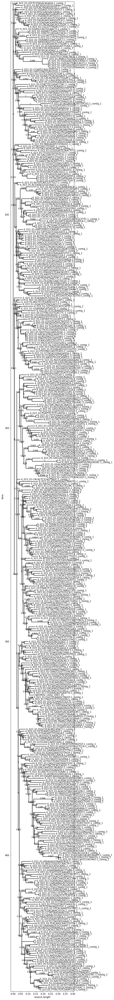

In [169]:
from Bio.Phylo import draw
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(5, 80))
draw(tree, axes=ax)
ax.spines['right'].set_visible(False)

In [160]:
draw?

In [8]:
filter_all = filter_all.reset_index()

In [9]:
translate_change = []
for i in range(len(filter_all)):
    
    # remove '.' dots
    somatic = filter_all.loc[i, "sequence_alignment"].replace(".", "")
    germline = filter_all.loc[i, "germline_alignment"].replace(".", "")
    somatic = somatic.replace("-", "N")
    germline = germline.replace("-", "N")
    diff = []
    shorter = min(len(germline), len(somatic))
    for j in range(shorter):
        if ((germline[j] != 'N') and (somatic[j] != 'N')) and (germline[j] != somatic[j]):
            aa_diff = {"pos": j, "first_frame": "", "second_frame": "", "third_frame": ""}
            #  situation 1 ..* - ..*
            if j >= 2:
                somatic_frame_1 = Seq(somatic[j-2:j+1]).translate()
                germline_frame_1 = Seq(germline[j-2:j+1]).translate()
                # print(somatic_frame_1 + " vs " + germline_frame_1 + " at pos " + str(j))
                if somatic_frame_1 == germline_frame_1:
                    aa_diff["first_frame"] = "synonymous"
                else:
                    aa_diff["first_frame"] = "non-synonymous"
                
            # situation 2 .*. - .*.
            if j >= 1 and j <= shorter-2:
                somatic_frame_2 = Seq(somatic[j-1:j+2]).translate()
                germline_frame_2 = Seq(germline[j-1:j+2]).translate()
                # print(somatic_frame_2 + " vs " + germline_frame_2 + " at pos " + str(j))
                if somatic_frame_2 == germline_frame_2:
                    aa_diff["second_frame"] = "synonymous"
                else:
                    aa_diff["second_frame"] = "non-synonymous"
            
            # situation 3 *.. *..
            if j <= shorter-3:
                somatic_frame_3 = Seq(somatic[j:j+3]).translate()
                germline_frame_3 = Seq(germline[j:j+3]).translate()
                # print(somatic_frame_3 + " vs " + germline_frame_3 + " at pos " + str(j))
                if somatic_frame_3 == germline_frame_3:
                    aa_diff["third_frame"] = "synonymous"
                else:
                    aa_diff["third_frame"] = "non-synonymous"
            diff.append(aa_diff)
    translate_change.append(diff)
    
filter_all["Amino_acid_change"] = translate_change

In [12]:
with_mutation_types = filter_all
with_mutation_types

,index,unique_contig_id,chain,sequence_alignment,germline_alignment,clone_id,mutations,patient_id,Amino_acid_change
0,0,1_002-GGGAATGCATTGCGGC-1_contig_2,IGH,GACGTGCAGCTGGTGGAGTCTGGGGGA...GACCTGGTACAGCCTG...,GAGGTGCAGCTGGTGGAGTCTGGGGGA...GGCTTGGTACAGCCTG...,1000_384,14,1_002,"[{'pos': 2, 'first_frame': 'non-synonymous', '..."
1,1,1_002-CCACCTACATGTAGTC-1_contig_2,IGH,GACGTGCAGCTGGTGGAGTCTGGGGGA...GACCTGGTACAGCCTG...,GAGGTGCAGCTGGTGGAGTCTGGGGGA...GGCTTGGTACAGCCTG...,1000_384,14,1_002,"[{'pos': 2, 'first_frame': 'non-synonymous', '..."
2,2,1_002-GGGCATCAGTTTCCTT-1_contig_2,IGH,GAGGTGCAACTGGTGGAGTCTGGGGGA...GGCTTGGTACAGCCTG...,GAGGTGCAGCTGGTGGAGTCTGGGGGA...GGCTTGGTACAGCCTG...,1002_744,11,1_002,"[{'pos': 8, 'first_frame': 'synonymous', 'seco..."
3,3,1_002-CTAGCCTAGGTAGCCA-1_contig_2,IGH,GAGGTGCAACTGGAGGAGTCTGGGGGA...GGCTTGGTACAGCCTG...,GAGGTGCAGCTGGTGGAGTCTGGGGGA...GGCTTGGTACAGCCTG...,1003_712,14,1_002,"[{'pos': 8, 'first_frame': 'synonymous', 'seco..."
4,4,1_002-CAGAGAGTCAAGCCTA-1_contig_2,IGH,GAGGTGCAGCTGGTGGAGTCTGGGGGA...GGCCTGGTACAGCCTG...,GAGGTGCAGCTGGTGGAGTCTGGGGGA...GGCTTGGTACAGCCTG...,1004_186,14,1_002,"[{'pos': 30, 'first_frame': 'synonymous', 'sec..."
...,...,...,...,...,...,...,...,...,...
22599,23055,6_023_01-CAAGAAACAGTCTTCC-1_contig_2,IGH,......CAACTGTTGGAGTCTGGGGGA...GGCTTGGTTCAGCCTG...,GAGGTGCAGCTGTTGGAGTCTGGGGGA...GGCTTGGTACAGCCTG...,998_717,46,6_023_01,"[{'pos': 0, 'first_frame': '', 'second_frame':..."
22600,23056,6_023_01-TTGGCAAAGGCAGGTT-1_contig_3,IGH,......CAGCTGTTGGAGTCTGGGGGA...GGCTTGGTTCAGCCTG...,GAGGTGCAGCTGTTGGAGTCTGGGGGA...GGCTTGGTACAGCCTG...,998_717,39,6_023_01,"[{'pos': 0, 'first_frame': '', 'second_frame':..."
22601,23057,6_023_01-CACATAGTCATCGATG-1_contig_2,IGH,GAGGTGCAGTTGTTGGAGTCTGGGGGA...GGCTTCGTACAGCCCG...,GAGGTGCAGCTGTTGGAGTCTGGGGGA...GGCTTGGTACAGCCTG...,999_672,19,6_023_01,"[{'pos': 9, 'first_frame': 'synonymous', 'seco..."
22602,23058,6_023_01-TCCCGATCACCAACCG-1_contig_2,IGH,CAGGTGCAACTACAACAATGGGGCGCA...GGACTGTTGAAGCCTT...,CAGGTGCAGCTACAACAGTGGGGCGCA...GGACTGTTGAAGCCTT...,99_329,19,6_023_01,"[{'pos': 8, 'first_frame': 'synonymous', 'seco..."


In [ ]:
for i in range(len(with_mutation_types["Amino_acid_change"])):
    print(with_mutation_types["unique_contig_id"][i] + ": ")
    for diff in with_mutation_types["Amino_acid_change"][i]:
        print(diff)

1_002-GGGAATGCATTGCGGC-1_contig_2: 
{'pos': 2, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 28, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 30, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 90, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 141, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 168, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 169, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 173, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 206, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame'

{'pos': 57, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 90, 'first_frame': 'synonymous', 'second_frame': 'synonymous', 'third_frame': 'non-synonymous'}
{'pos': 91, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 94, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 97, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 101, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 116, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 141, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 144, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 156,

{'pos': 31, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 32, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 33, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 35, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 36, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 37, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 38, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 39, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 40, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synon

{'pos': 331, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 338, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-CATGGCGCACCAGTTA-1_contig_3: 
{'pos': 83, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 88, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 91, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 93, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 97, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 104, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 137, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame'

{'pos': 82, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 88, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 91, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 150, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 172, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 175, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 240, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 261, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 262, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 27

{'pos': 104, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 130, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 143, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 157, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 158, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 160, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 162, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 163, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 167, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymo

{'pos': 262, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 276, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 289, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 309, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 312, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 317, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 324, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 355, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 356, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-TGCTGCTCA

{'pos': 160, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 162, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 166, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 169, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 179, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 250, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 262, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 266, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 306, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}

{'pos': 265, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 266, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 267, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 270, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 271, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 272, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 273, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 274, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 276, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-syno

{'pos': 333, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 336, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 337, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 338, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 339, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 340, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 341, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 343, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 344, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-

{'pos': 90, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 91, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 92, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 149, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 157, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 169, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 170, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 246, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 248, 'first_frame': 'non-synonymous', 'second_frame': 'synonymous', 'third_frame': 'non-synonymous'}
{'pos'

{'pos': 8, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 28, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 66, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 91, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 97, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 146, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 166, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 175, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 181, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 2

{'pos': 242, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 243, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 246, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 247, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 248, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 250, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 251, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 252, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 253, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 62, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 76, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 109, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 156, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 163, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 164, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 169, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 172, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 175, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous

1_002-ACACCGGGTTGGAGGT-1_contig_1: 
{'pos': 8, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 76, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 79, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 95, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 109, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 166, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 169, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 172, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 177, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', '

{'pos': 80, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 94, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 95, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 100, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 109, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 134, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 158, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 163, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 169, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'

{'pos': 97, 'first_frame': 'non-synonymous', 'second_frame': 'synonymous', 'third_frame': 'non-synonymous'}
{'pos': 204, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 216, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 247, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 253, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 316, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-ACTTACTTCAATAAGG-1_contig_2: 
{'pos': 2, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 79, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 88, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', '

{'pos': 167, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 174, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 209, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 220, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 233, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 242, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 250, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 259, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 261, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos':

{'pos': 189, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 196, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 215, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 216, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 228, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 234, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 236, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 337, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 338, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos':

{'pos': 177, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 185, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 200, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 216, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 218, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 228, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 231, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 247, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 254, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 279, 'f

{'pos': 357, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 358, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 359, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 360, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 361, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': ''}
{'pos': 362, 'first_frame': 'non-synonymous', 'second_frame': '', 'third_frame': ''}
1_002-TAGGCATTCACATGCA-1_contig_2: 
{'pos': 29, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 33, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 84, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}


{'pos': 207, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 215, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 216, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 228, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 249, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 263, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 313, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 335, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 345, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-C

{'pos': 99, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 108, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 165, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 168, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 179, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 186, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 199, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 216, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 245, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 252,

{'pos': 315, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 316, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 317, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 318, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 325, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 327, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 328, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 330, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 331, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 95, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 103, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 149, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 161, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 165, 'first_frame': 'synonymous', 'second_frame': 'synonymous', 'third_frame': 'non-synonymous'}
{'pos': 166, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 167, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 171, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 217, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 233, 'first_fram

{'pos': 184, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 185, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 186, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 187, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 188, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 189, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 191, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 192, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 194, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 327, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 328, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 329, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 330, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 334, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 335, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 336, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 337, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 338, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 193, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 194, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 195, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 196, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 197, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 198, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 199, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 201, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 203, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 100, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 102, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 103, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 104, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 105, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 106, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 107, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 108, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 109, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 278, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 284, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 290, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 336, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-AGCAGCCAGAGTGAGA-1_contig_2: 
{'pos': 8, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 81, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 82, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 91, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 92, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame':

{'pos': 228, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 230, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 239, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 250, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 251, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 258, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 259, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 260, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 267, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}

{'pos': 215, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 216, 'first_frame': 'non-synonymous', 'second_frame': 'synonymous', 'third_frame': 'non-synonymous'}
{'pos': 236, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 248, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 253, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 258, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 267, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 281, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 286, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos':

{'pos': 53, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 54, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 56, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 57, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 58, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 59, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 61, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 62, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 63, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 

{'pos': 165, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 166, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 173, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 222, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 257, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 266, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 276, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 316, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 319, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}

{'pos': 263, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 264, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 265, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 266, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 267, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 268, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 269, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 271, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 272, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 190, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 191, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 192, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 193, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 194, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 195, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 196, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 198, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 199, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-syno

{'pos': 4, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 5, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 7, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 9, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 12, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 15, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 16, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 17, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 20, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}


{'pos': 341, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 342, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 343, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 344, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 345, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 346, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 348, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': ''}
{'pos': 349, 'first_frame': 'non-synonymous', 'second_frame': '', 'third_frame': ''}
1_002-TACAGTGCAGACGCTC-1_contig_2: 
{'pos': 9, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-syno

{'pos': 137, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 150, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 152, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 170, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 171, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 182, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 226, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 233, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 234, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'p

{'pos': 364, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 366, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 369, 'first_frame': 'synonymous', 'second_frame': '', 'third_frame': ''}
1_002-TGCCCTAGTTCAGACT-1_contig_2: 
{'pos': 3, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 30, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 74, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 81, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 89, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 92, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 96

{'pos': 289, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 290, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 291, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 293, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 294, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 296, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 297, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 303, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 304, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-syno

{'pos': 163, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 164, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 165, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 167, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 169, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 170, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 171, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 172, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 173, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

1_002-CATGACAAGAAACCTA-1_contig_2: 
{'pos': 77, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 90, 'first_frame': 'synonymous', 'second_frame': 'synonymous', 'third_frame': 'non-synonymous'}
{'pos': 164, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 185, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 199, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 227, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 233, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 236, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 240, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-sy

{'pos': 29, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 31, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 32, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 33, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 35, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 36, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 37, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 38, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 39, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synon

{'pos': 246, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 247, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 248, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 250, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 251, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 252, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 253, 'first_frame': 'non-synonymous', 'second_frame': 'synonymous', 'third_frame': 'non-synonymous'}
{'pos': 254, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 255, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymo

{'pos': 133, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 157, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 207, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 213, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 307, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 311, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 349, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 350, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-GGACGTCAGGCTAGGT-1_contig_2: 
{'pos': 25, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'thir

{'pos': 135, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 136, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 137, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 139, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 141, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 143, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 144, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 145, 'first_frame': 'non-synonymous', 'second_frame': 'synonymous', 'third_frame': 'non-synonymous'}
{'pos': 146, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymo

1_002-AATCCAGTCACATGCA-1_contig_2: 
{'pos': 4, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 91, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 157, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 160, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 164, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 167, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 173, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 176, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 233, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non

{'pos': 138, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 140, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 141, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 144, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 145, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 146, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 147, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 148, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 149, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-

{'pos': 315, 'first_frame': 'synonymous', 'second_frame': 'synonymous', 'third_frame': 'non-synonymous'}
{'pos': 316, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 348, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 371, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-GGGAGATAGGCGTACA-1_contig_1: 
{'pos': 8, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 67, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 72, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 89, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 154, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-s

{'pos': 189, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 214, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 230, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 245, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 278, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 312, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 313, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 316, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-GAACGGAGTCTTTCAT-1_contig_2: 
{'pos': 9, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third

{'pos': 186, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 187, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 188, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 189, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 190, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 191, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 195, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 197, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 198, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-

{'pos': 197, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 217, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 227, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 229, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 250, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 251, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 263, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 275, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 308, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'p

{'pos': 17, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 70, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 73, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 82, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 91, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 93, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 143, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 147, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 149, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 152, 

{'pos': 5, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 8, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 9, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 15, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 67, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 68, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 91, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 92, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 104, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 137, 'firs

{'pos': 379, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-GTACTCCAGGTGCTTT-1_contig_1: 
{'pos': 82, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 83, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 88, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 91, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 95, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 96, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 98, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 155, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous',

{'pos': 134, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 136, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 138, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 139, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 140, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 141, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 143, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 144, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 145, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 93, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 99, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 131, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 158, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 159, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 163, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 172, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 174, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 179, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{

{'pos': 246, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 253, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 278, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 284, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 289, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 290, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 341, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 347, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 372, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-TCAACGACAGGCT

{'pos': 150, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 151, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 152, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 153, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 155, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 156, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 158, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 159, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 161, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 245, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 250, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 291, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 302, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 310, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 365, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 386, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-TCGAGGCAGGTAGCCA-1_contig_1: 
{'pos': 82, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 90, 'first_frame': 'synonymous', 'second_frame': 'synonymous', 'third_frame': 'non-sy

{'pos': 127, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 128, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 130, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 132, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 134, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 135, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 136, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 137, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 138, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 175, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 176, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 179, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 193, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 233, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 258, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 277, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 278, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 340, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 355

{'pos': 336, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 337, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 338, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 339, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 340, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 341, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 342, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 343, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 344, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 55, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 56, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 57, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 58, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 59, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 60, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 62, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 63, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 65, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synon

{'pos': 338, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-GTGTGCGTCGCATGGC-1_contig_2: 
{'pos': 3, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 9, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 47, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 82, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 83, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 90, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 92, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 93, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame':

{'pos': 149, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 150, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 151, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 152, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 153, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 154, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 156, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 157, 'first_frame': 'non-synonymous', 'second_frame': 'synonymous', 'third_frame': 'non-synonymous'}
{'pos': 158, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymo

{'pos': 323, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 326, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 328, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-ATCACGATCCACGTGG-1_contig_3: 
{'pos': 41, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 70, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 81, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 82, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 90, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 92, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_fra

{'pos': 249, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 278, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 288, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 293, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 317, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 338, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 343, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 344, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-AGATCTGAGGTTACCT-1_contig_2: 
{'pos': 53, 'first_frame': 'synonymous', 'second_frame': 'synonymous', 'third_frame': 'non-s

{'pos': 178, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 179, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 182, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 183, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 184, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 187, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 189, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 191, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 193, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-

{'pos': 160, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 178, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 185, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 186, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 187, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 208, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 215, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 216, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 236, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'p

{'pos': 79, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 109, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 160, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 164, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 174, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 177, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 204, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 236, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 239, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 

{'pos': 161, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 169, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 175, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 176, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 236, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 240, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 245, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 342, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 343, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-C

{'pos': 226, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 273, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 312, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 342, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 343, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 349, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-GATTCAGAGAAGGTTT-1_contig_2: 
{'pos': 2, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 5, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 16, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame'

{'pos': 160, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 166, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 204, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 206, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 210, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 222, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 226, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 243, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 245, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymo

{'pos': 96, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 137, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 151, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 160, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 165, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 166, 'first_frame': 'non-synonymous', 'second_frame': 'synonymous', 'third_frame': 'non-synonymous'}
{'pos': 169, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 179, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 181, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 195,

{'pos': 288, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 290, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 292, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 295, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 296, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 297, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 298, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 301, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 303, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-

{'pos': 169, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 177, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 180, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 188, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 198, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 229, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 245, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 248, 'first_frame': 'synonymous', 'second_frame': 'synonymous', 'third_frame': 'non-synonymous'}
{'pos': 292, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-TACGGTAGT

{'pos': 90, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 91, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 92, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 93, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 94, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 95, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 97, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 98, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 99, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synon

{'pos': 124, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 151, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 158, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 162, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 163, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 180, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 182, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 236, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 237, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 294

{'pos': 276, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 288, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 338, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 340, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-CCTCAGTTCAAGGTAA-1_contig_1: 
{'pos': 9, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 28, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 54, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 82, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 94, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_fra

{'pos': 173, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 207, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 225, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 233, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 236, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 278, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-ACGCAGCTCTAAGCCA-1_contig_2: 
{'pos': 35, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 39, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 94, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 

{'pos': 252, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 254, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 255, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 256, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 257, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 258, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 260, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 262, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 263, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'syno

{'pos': 219, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 220, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 231, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 236, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 238, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 242, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 253, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 284, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 289, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 342, 'f

{'pos': 308, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 333, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 335, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 337, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 377, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-CACCACTAGGACTGGT-1_contig_2: 
{'pos': 71, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 82, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 92, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 129, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_fram

{'pos': 127, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 129, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 130, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 131, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 132, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 133, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 134, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 136, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 138, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 159, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 160, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 161, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 163, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 164, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 165, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 166, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 167, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 168, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 338, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 344, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 349, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 375, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-GTATTCTTCCTCAACC-1_contig_2: 
{'pos': 77, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 91, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 95, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 103, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 118, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonym

{'pos': 254, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 255, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 256, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 257, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 258, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 259, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 260, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 262, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 263, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 250, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 254, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 255, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 262, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 278, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 284, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 343, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 348, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-CACATAGGTTAAGGGC-1_contig_4: 
{'pos': 2, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'no

{'pos': 68, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 70, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 86, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 90, 'first_frame': 'synonymous', 'second_frame': 'synonymous', 'third_frame': 'non-synonymous'}
{'pos': 91, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 96, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 148, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 149, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 155, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos

{'pos': 343, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 348, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-GAAACTCTCCGAATGT-1_contig_1: 
{'pos': 2, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 9, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 15, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 62, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 67, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 68, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 70, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_fr

{'pos': 86, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 90, 'first_frame': 'synonymous', 'second_frame': 'synonymous', 'third_frame': 'non-synonymous'}
{'pos': 91, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 96, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 148, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 149, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 155, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 159, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 162, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 164

{'pos': 114, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 115, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 116, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 117, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 119, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 120, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 121, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 122, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 124, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 272, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 276, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 278, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 280, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 281, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 282, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 283, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 284, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 285, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-syno

{'pos': 264, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 265, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 266, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 267, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 270, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 271, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 272, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 273, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 274, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 245, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 250, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 262, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 292, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 317, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 320, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 326, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-TATCTCAAGAGCAATT-1_contig_1: 
{'pos': 9, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 88, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-syn

{'pos': 170, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 229, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 284, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 349, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-AGGTCATCACGGTTTA-1_contig_1: 
{'pos': 98, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 109, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 133, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 152, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 160, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-s

{'pos': 53, 'first_frame': 'synonymous', 'second_frame': 'synonymous', 'third_frame': 'non-synonymous'}
{'pos': 88, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 91, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 92, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 99, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 101, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 104, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 129, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 133, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 148,

{'pos': 90, 'first_frame': 'non-synonymous', 'second_frame': 'synonymous', 'third_frame': 'non-synonymous'}
{'pos': 91, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 96, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 118, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 127, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 136, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 158, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 166, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 170, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 171, '

{'pos': 118, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 149, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 157, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 168, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 174, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 175, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 214, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 230, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 278, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-T

{'pos': 68, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 81, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 86, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 89, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 91, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 126, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 148, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 149, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 153, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 

{'pos': 324, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 325, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 326, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 327, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 331, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 332, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 333, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 334, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 337, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-syno

{'pos': 214, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 215, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 216, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 217, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 218, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 220, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 222, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 224, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 225, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 279, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 280, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 283, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 284, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 285, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 286, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 287, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 288, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 289, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 160, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 161, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 169, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 172, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 181, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 182, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 183, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 187, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 188, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'p

{'pos': 347, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-CGCTATCCAGCCAATT-1_contig_1: 
{'pos': 9, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 17, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 41, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 69, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 74, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 78, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 80, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 90, 'first_frame': 'synonymous', 'second_frame': 'synonymous', 'third_frame': 'non-synon

1_002-CAGCAGCCACTAAGTC-1_contig_1: 
{'pos': 8, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 44, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 56, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 66, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 94, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 98, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 102, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 137, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 147, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 

{'pos': 55, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 88, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 91, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 102, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 103, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 124, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 135, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 147, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 156, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'

{'pos': 196, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-AGAATAGCATGACGGA-1_contig_2: 
{'pos': 91, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 103, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 168, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 170, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 174, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 206, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 209, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 214, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'thir

{'pos': 160, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 163, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 165, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 166, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 173, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 194, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 200, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 215, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 233, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'p

{'pos': 349, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-ACATGGTTCGAATCCA-1_contig_2: 
{'pos': 62, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 82, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 89, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 141, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 153, 'first_frame': 'synonymous', 'second_frame': 'synonymous', 'third_frame': 'non-synonymous'}
{'pos': 154, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 157, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 163, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non

{'pos': 157, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 160, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 172, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 181, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 183, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 189, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 196, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 229, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 257, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'p

{'pos': 196, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 229, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 257, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 311, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 327, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 347, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 348, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-GAACATCAGAGACTAT-1_contig_2: 
{'pos': 59, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 72, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_fra

{'pos': 344, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 348, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 392, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-CGTCAGGAGCTAGTCT-1_contig_2: 
{'pos': 2, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 8, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 51, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 55, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 71, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 75, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymo

{'pos': 141, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 163, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 164, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 168, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 183, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 185, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 188, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 191, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 194, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}

{'pos': 326, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 327, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 347, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 348, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 360, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 392, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-TTAACTCAGAATGTGT-1_contig_4: 
{'pos': 7, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 25, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 34, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_f

{'pos': 224, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 234, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 236, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 245, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 327, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 344, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 348, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 368, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 393, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-TAGGCATGTCTAA

{'pos': 267, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 268, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 269, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 270, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 271, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 272, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 274, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 275, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 276, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 62, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 63, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 64, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 65, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 66, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 69, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 71, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 72, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 73, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymou

{'pos': 228, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 234, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 238, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 250, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 276, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 278, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 281, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 283, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 284, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 299, 'f

{'pos': 46, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 67, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 70, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 82, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 87, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 88, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 89, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 90, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 92, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'po

{'pos': 104, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 105, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 106, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 107, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 108, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 109, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 110, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 111, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 112, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 172, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 178, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 195, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 204, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 208, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 215, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 216, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 218, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 230, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymo

{'pos': 362, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 363, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 364, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 365, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 366, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 367, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 368, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 369, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 371, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 192, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 193, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 194, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 195, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 196, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 197, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 198, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 199, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 200, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-

{'pos': 42, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 43, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 44, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 45, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 46, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 47, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 48, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 51, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 52, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymou

{'pos': 334, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 338, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 340, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 341, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 342, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 343, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 344, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 346, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 347, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 274, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 275, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 277, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 278, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 280, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 281, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 282, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 283, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 284, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 166, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 171, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 172, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 177, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 196, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 200, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 204, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 212, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 218, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 228, 'f

{'pos': 161, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 165, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 166, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 173, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 174, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 178, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 195, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 207, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 212, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 233

{'pos': 275, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 278, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
1_002-AGCGTATAGACGCTTT-1_contig_2: 
{'pos': 51, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 76, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 80, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 82, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 83, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 87, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 126, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame':

{'pos': 235, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 263, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 275, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 281, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
1_002-CTTTGCGAGCACCGTC-1_contig_1: 
{'pos': 3, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 9, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 34, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 35, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 41, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non

{'pos': 9, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 86, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 92, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 94, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 96, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 97, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 100, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 161, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 162, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'

{'pos': 334, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 360, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 368, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-CGATCGGAGGACTGGT-1_contig_2: 
{'pos': 88, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 90, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 93, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 97, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 125, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 145, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'thi

{'pos': 152, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 161, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 166, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 171, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 172, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 176, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 184, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 204, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 220, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'p

{'pos': 173, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 190, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 224, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 240, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 245, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 250, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 251, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 261, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 266, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos':

{'pos': 23, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 24, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 25, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 26, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 28, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 29, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 31, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 32, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 33, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synon

{'pos': 198, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 235, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 245, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 250, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 251, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 313, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-ACACTGAAGCTTTGGT-1_contig_2: 
{'pos': 8, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 66, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 86, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-

{'pos': 250, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 252, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 253, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 258, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 263, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 278, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 309, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 365, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 379, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}

{'pos': 97, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 158, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 170, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 187, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 278, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 293, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 311, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 322, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 324, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 336, 'fi

{'pos': 89, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 91, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 94, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 95, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 97, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 102, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 140, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 158, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 166, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 

{'pos': 245, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 248, 'first_frame': 'synonymous', 'second_frame': 'synonymous', 'third_frame': 'non-synonymous'}
{'pos': 366, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 372, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 373, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 374, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 380, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-TGAGCCGTCGAGCCCA-1_contig_2: 
{'pos': 8, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 69, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 

{'pos': 122, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 141, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 144, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 149, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 156, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 162, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 166, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 168, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 172, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos':

{'pos': 128, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 145, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 146, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 147, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 163, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 166, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 169, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 175, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 178, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}

{'pos': 307, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 308, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 309, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 330, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 333, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 334, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 335, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 336, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 337, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-syno

{'pos': 354, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-GGAGCAAAGCGTTCCG-1_contig_2: 
{'pos': 3, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 56, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 93, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 96, 'first_frame': 'synonymous', 'second_frame': 'synonymous', 'third_frame': 'non-synonymous'}
{'pos': 97, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 109, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 122, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 123, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'no

{'pos': 6, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 7, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 8, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 9, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 10, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 12, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 13, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 14, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 15, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymou

{'pos': 176, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 177, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 182, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 193, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 196, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 233, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 236, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 250, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 251, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'p

{'pos': 140, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 141, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 144, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 145, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 146, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 148, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 149, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 151, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 152, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-

{'pos': 161, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 162, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 166, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 167, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 169, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 173, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 188, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 193, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 200, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'p

{'pos': 41, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 42, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 43, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 44, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 45, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 46, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 47, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 48, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 49, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synon

{'pos': 1, 'first_frame': '', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 3, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 4, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 5, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 6, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 7, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 8, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 9, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 10, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 12, 'f

{'pos': 53, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 89, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 91, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 163, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 166, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 167, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 172, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 177, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 179, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'

{'pos': 250, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 261, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 266, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 276, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 278, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 281, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 283, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 334, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 348, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-GAAAC

{'pos': 281, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 282, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 283, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 285, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 286, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 287, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 290, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 292, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 293, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 99, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 103, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 122, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 147, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 148, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 152, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 154, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 158, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 165, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 

{'pos': 102, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 104, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 106, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 107, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 109, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 111, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 113, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 115, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 116, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-syno

{'pos': 99, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 101, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 102, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 104, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 107, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 109, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 110, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 111, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 113, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synon

{'pos': 241, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 242, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 243, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 244, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 245, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 246, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 247, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 248, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 249, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 85, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 86, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 87, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 89, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 91, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 92, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 93, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 94, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 95, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synon

{'pos': 304, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 305, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 306, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 307, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 308, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 309, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 314, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 315, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 316, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 151, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 153, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 154, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 155, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 156, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 158, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 159, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 160, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 161, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 268, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 269, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 270, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 273, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 274, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 275, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 276, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 278, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 279, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-

{'pos': 128, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 129, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 130, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 132, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 133, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 136, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 137, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 141, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 142, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-

{'pos': 265, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 266, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 267, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 268, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 269, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 270, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 273, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 274, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 275, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-

{'pos': 200, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 201, 'first_frame': 'non-synonymous', 'second_frame': 'synonymous', 'third_frame': 'non-synonymous'}
{'pos': 202, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 203, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 204, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 205, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 206, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 207, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 208, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymo

{'pos': 41, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 42, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 43, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 44, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 45, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 46, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 47, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 49, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 51, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synon

{'pos': 129, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 130, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 132, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 133, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 136, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 137, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 141, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 142, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 143, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-

{'pos': 318, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 320, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 322, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 324, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 325, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 326, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 328, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 329, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 330, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 267, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 281, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 284, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 294, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 296, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 352, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 363, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-CCTTCGAAGATGTAAC-1_contig_3: 
{'pos': 74, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 113, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_fr

{'pos': 199, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 245, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 277, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 287, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 304, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 310, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 323, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 359, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-CCACTACAGCCACGCT-1_contig_5: 
{'pos': 0, 'first_frame': '', 'second_frame': '', 'third_frame': 'non-synonymous'}
{'pos

{'pos': 8, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 96, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 102, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 104, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 123, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 137, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 177, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 178, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 185, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 197, '

{'pos': 287, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 292, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 346, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-AGTAGTCCATTGGCGC-1_contig_1: 
{'pos': 3, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 8, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 96, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 102, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 104, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 123, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synon

{'pos': 67, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 68, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 69, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 70, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 71, 'first_frame': 'non-synonymous', 'second_frame': 'synonymous', 'third_frame': 'non-synonymous'}
{'pos': 73, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 74, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 75, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 76, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}


{'pos': 68, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 69, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 70, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 71, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 72, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 73, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 74, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 75, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 76, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymou

{'pos': 97, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 99, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 131, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 144, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 163, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 164, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 166, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 169, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 184, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synony

{'pos': 216, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 217, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 218, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 220, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 221, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 222, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 224, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 225, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 226, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 277, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 278, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 279, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 280, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 281, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 284, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 286, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 287, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 288, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymo

{'pos': 232, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 233, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 234, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 235, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 236, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 237, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 238, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 242, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 243, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-

{'pos': 173, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 176, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 177, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 178, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 179, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 180, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 181, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 182, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 183, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-

{'pos': 346, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 348, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 349, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 350, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 351, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 353, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 354, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 355, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 356, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 303, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 304, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 306, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 307, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 308, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 309, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 311, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 313, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 314, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 125, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 152, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 156, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 161, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 169, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 172, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 181, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 185, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 221, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos':

{'pos': 186, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 189, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 201, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 206, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 212, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 226, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 247, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 256, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 280, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'p

{'pos': 91, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 95, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 96, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 97, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 98, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 103, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 108, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 131, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 143, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'po

{'pos': 220, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 291, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 293, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 337, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 338, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 341, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 345, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-CCTAAAGTCAGTCCCT-1_contig_1: 
{'pos': 8, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 79, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_fram

{'pos': 354, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 355, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 356, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 357, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 358, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 360, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 361, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': ''}
{'pos': 362, 'first_frame': 'non-synonymous', 'second_frame': '', 'third_frame': ''}
1_002-AGACGTTGTTTGTTGG-1_contig_1: 
{'pos': 8, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-syno

{'pos': 108, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 143, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 148, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 156, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 158, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 162, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 172, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 173, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 174, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos':

{'pos': 103, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 146, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 150, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 152, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 156, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 161, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 163, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 164, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 176, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymo

{'pos': 67, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 91, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 92, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 97, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 125, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 131, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 149, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 160, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 162, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 168, 'f

{'pos': 163, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 166, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 167, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 170, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 171, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 234, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 250, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 253, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 254, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymo

{'pos': 63, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 65, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 66, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 67, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 68, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 69, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 71, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 77, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 79, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymou

{'pos': 101, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 102, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 104, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 145, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 148, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 149, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 165, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 166, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 168, 'first_frame': 'non-synonymous', 'second_frame': 'synonymous', 'third_frame': 'non-synonymous'}
{'p

{'pos': 207, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 224, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 230, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 234, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 240, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 250, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 251, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 252, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 254, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'p

{'pos': 70, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 80, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 92, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 102, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 148, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 149, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 165, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 166, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 168, 'first_frame': 'non-synonymous', 'second_frame': 'synonymous', 'third_frame': 'non-synonymous'}
{'pos'

{'pos': 92, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 102, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 148, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 158, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 165, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 166, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 167, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 168, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 181, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'po

{'pos': 147, 'first_frame': 'non-synonymous', 'second_frame': 'synonymous', 'third_frame': 'non-synonymous'}
{'pos': 152, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 158, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 167, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 169, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 172, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 175, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 178, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 180, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos':

{'pos': 249, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 251, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 252, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 253, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 254, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 255, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 256, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 259, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 260, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 236, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 238, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 240, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 241, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 242, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 243, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 245, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 246, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 247, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 167, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 172, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 227, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 234, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 254, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 262, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 278, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_002-GTTAAGCAGCGAAGGG-1_contig_2: 
{'pos': 57, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 59, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous'

{'pos': 122, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 126, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 127, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 130, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 132, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 133, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 135, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 136, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 137, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-syno

{'pos': 372, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_075-GAACATCGTTATCGGT-1_contig_2: 
{'pos': 106, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 107, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 124, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 153, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 163, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 184, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 207, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 216, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 

{'pos': 345, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 348, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 349, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 350, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 351, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 353, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 354, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 355, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 357, 'first_frame': 'non-synonymous', 'second_frame': '', 'third_frame': ''}
1_075-AAGGCAGTC

{'pos': 340, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 341, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 342, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 343, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 345, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 347, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 348, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 349, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 350, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-

{'pos': 74, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 82, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 86, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 88, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 91, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 92, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 93, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 97, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 103, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}

{'pos': 150, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 152, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 157, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 161, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 166, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 173, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 182, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 201, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 238, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 248

{'pos': 238, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 251, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 278, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 289, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 308, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 349, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_075-AGCTCCTTCTGGGCCA-1_contig_2: 
{'pos': 8, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 17, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 82, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'thi

{'pos': 193, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 194, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 196, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 197, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 198, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 199, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 201, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 202, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 203, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 262, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 263, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 264, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 265, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 266, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 267, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 270, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 271, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 272, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-

{'pos': 254, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 255, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 256, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 258, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 260, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 261, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 262, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 263, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 265, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-syno

{'pos': 146, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 151, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 158, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 166, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 169, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 234, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 302, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 341, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 367, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_075-CATCAGAAG

{'pos': 229, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 237, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 261, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 276, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 278, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 312, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 342, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 346, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 352, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos':

{'pos': 7, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 9, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 10, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 11, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 12, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 13, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 14, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 15, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 16, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonym

{'pos': 181, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 182, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 183, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 184, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 185, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 186, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 187, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 188, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 189, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 101, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 137, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 162, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 164, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 169, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 180, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 195, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 282, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 284, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'p

{'pos': 175, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 176, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 177, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 178, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 179, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 180, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 181, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 182, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 183, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 92, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 103, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 135, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 149, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 156, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 157, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 173, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 200, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 229, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'po

{'pos': 245, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 255, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 258, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 262, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 278, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 283, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 304, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 309, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 312, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos':

{'pos': 358, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 360, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 361, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 362, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 363, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 365, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 366, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 367, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 368, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 169, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 173, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 176, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 205, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 219, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 226, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 259, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 305, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 338, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 341, 'f

{'pos': 92, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 159, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 176, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 185, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 188, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 246, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 282, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
1_075-TACAGTGCAGACACTT-1_contig_2: 
{'pos': 29, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 92, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_fram

{'pos': 175, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 188, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 331, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 338, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
1_075-ACGGAGACAGCTCGCA-1_contig_2: 
{'pos': 2, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 8, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 17, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 25, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 37, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonym

{'pos': 180, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 189, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 229, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 250, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 325, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 326, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 329, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 332, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
1_075-ATGAGGGGTCACCCAG-1_contig_2: 
{'pos': 4, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame':

{'pos': 25, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 30, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 36, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 69, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 88, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 91, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 101, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 103, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 104, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 1

1_075-CGAATGTGTCCCTACT-1_contig_1: 
{'pos': 8, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 88, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 99, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 102, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 176, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'synonymous'}
{'pos': 229, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 240, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 245, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 278, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': '

{'pos': 82, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 83, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 88, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 102, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 167, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 174, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 176, 'first_frame': 'non-synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 217, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos': 239, 'first_frame': 'synonymous', 'second_frame': 'non-synonymous', 'third_frame': 'non-synonymous'}
{'pos'